<h1 style="text-align:center; font-size:48px;">Market Analysis of Denver AirBnBs Using Inside AirBnB Data</h1>

<h2 style="text-align:center;">Final Project for 5304 Introduction to Data Visualization </h2>

-----------------------------------------------------------------------------------------------------------
### Part 1: Finding your Data
#### *"Locate a dataset..."*

[Inside AirBnB]("http://insideairbnb.com/about/") is an independent, mission driven project that provides scraped data and advocacy about AirBnB's impact on residential communities in cities around the world. They provide a dashboard with an interactive city map overlain with AirBnB rental locations. The map provides a hover tooltip that reveals host, property, rate, and rental activity over the last month and year. The dashboard shows bar charts and descriptive statistis related to room type, activity, short-term rentals, listings per host, and top host. The platform also provides downloadable datasets for each city that these dashboards are based upon.

Because I live near Denver in Boulder, Colorado, rent my house on AirBnB, and have a group of friends who do the same and are interested in the market, I decided to explore the Denver AirBnB data with the goal of producing additional insights on the market. Specifically, I would like to know what neighborhoods, property types, and hosting strategies are most profitable. I would also like to know how the market has changed over time and how it compares to other cities.

Throughout this project, I will referrence the assignment instructions in quotes and italics as shown above for "Locate a dataset..." to facilitate peer review.

#### Import Libraries

In [99]:
import pandas as pd
import altair as alt
import json
import copy
import matplotlib.pyplot as plt

#### Import Data

In [100]:
# Load GeoJSON data
with open('neighbourhoods.geojson', 'r') as f:
    denver_geo = json.load(f)

# Load AirBnB listing data
data = pd.read_csv("listings.csv")

# Copy the AirbnB listing data
listings = data.copy()

# Print column names
print("Column names:", listings.columns)
print("Total listings:", listings.shape[0])
print("Listing features:", listings.shape[1])

Column names: Index(['id', 'listing_url', 'scrape_id', 'last_scraped', 'source', 'name',
       'description', 'neighborhood_overview', 'picture_url', 'host_id',
       'host_url', 'host_name', 'host_since', 'host_location', 'host_about',
       'host_response_time', 'host_response_rate', 'host_acceptance_rate',
       'host_is_superhost', 'host_thumbnail_url', 'host_picture_url',
       'host_neighbourhood', 'host_listings_count',
       'host_total_listings_count', 'host_verifications',
       'host_has_profile_pic', 'host_identity_verified', 'neighbourhood',
       'neighbourhood_cleansed', 'neighbourhood_group_cleansed', 'latitude',
       'longitude', 'property_type', 'room_type', 'accommodates', 'bathrooms',
       'bathrooms_text', 'bedrooms', 'beds', 'amenities', 'price',
       'minimum_nights', 'maximum_nights', 'minimum_minimum_nights',
       'maximum_minimum_nights', 'minimum_maximum_nights',
       'maximum_maximum_nights', 'minimum_nights_avg_ntm',
       'maximum_nights

#### *"Discuss your dataset..."*
Inside AirBnB's [Denver dataset]("http://data.insideairbnb.com/united-states/co/denver/2023-09-24/data/listings.csv.gz") downloaded on December 3, 2023, at 10:07 AM includes 5,388 listings and 75 features. The dataset includes the following variables:

'id', 'listing_url', 'scrape_id', 'last_scraped', 'source', 'name', 'description', 'neighborhood_overview', 'picture_url', 'host_id','host_url', 'host_name', 'host_since', 'host_location', 'host_about', 'host_response_time', 'host_response_rate', 'host_acceptance_rate', 'host_is_superhost', 'host_thumbnail_url', 'host_picture_url', 'host_neighbourhood', 'host_listings_count', 'host_total_listings_count', 'host_verifications', 'host_has_profile_pic', 'host_identity_verified', 'neighbourhood', 'neighbourhood_cleansed', 'neighbourhood_group_cleansed', 'latitude', 'longitude', 'property_type', 'room_type', 'accommodates', 'bathrooms', 'bathrooms_text', 'bedrooms', 'beds', 'amenities', 'price', 'minimum_nights', 'maximum_nights', 'minimum_minimum_nights', 'maximum_minimum_nights', 'minimum_maximum_nights', 'maximum_maximum_nights', 'minimum_nights_avg_ntm', 'maximum_nights_avg_ntm', 'calendar_updated', 'has_availability', 'availability_30', 'availability_60', 'availability_90', 'availability_365', 'calendar_last_scraped', 'number_of_reviews', 'number_of_reviews_ltm', 'number_of_reviews_l30d', 'first_review', 'last_review', 'review_scores_rating', 'review_scores_accuracy', 'review_scores_cleanliness', 'review_scores_checkin', 'review_scores_communication', 'review_scores_location', 'review_scores_value', 'license', 'instant_bookable', 'calculated_host_listings_count', 'calculated_host_listings_count_entire_homes', 'calculated_host_listings_count_private_rooms', 'calculated_host_listings_count_shared_rooms', 'reviews_per_month'

Inside AirBnB's [neighbourhoods.geojson]('http://data.insideairbnb.com/united-states/co/denver/2023-09-24/visualisations/neighbourhoods.geojson') is a GeoJSON file of the 78 neighborhoods in Denver. This file will be used to create a base map of the neighborhoods that listings can be layered upon.

Key attributes that will be used in this analysis include neighbourhood_cleansed, latitude, longitude, property_type, room_type, price, minimum_nights, maximum_nights, availability_30, availability_60, availability_90, availability_365, number_of_reviews, review_scores_rating, calculated_host_listings_count, and reviews_per_month. 

While the existing visuals on the Inside AirBnB dashboard are helpful for getting a general feel of the distribution of property types and rental activity, the dashboards lacks more powerful features that would help potential investors make the most lucrative AirBnB acquisitions and management decisions. For example, the dashboard lacks a neighborhood filter that would provide summary statistics and enable easy comparison of features across neighborhoods. I intend to use the key attributes mentioned above to create interactive visualizations that help answer questions such as: "What type of property has the highest occupancy rate in a given neighborhood?" and "What is the average price per night for each property type in a given neighborhood?".

### Part 2: Sketching your Data

#### *"First, identify two to three tasks you would wish to complete with your data..."*

**TASK 1:** Identify neighborhoods with the highest occupancy rates.\

*"Why is a task pursued? (goal)"*\
To identify the most lucrative neighborhoods for AirBnB investment.

*"How is a task conducted? (means)"*\
Create a bar graph of occupancy rates for the top 10 - 20 neighborhoods.

*"What does a task seek to learn about the data? (characteristics)"*\
Which neighborhoods have the highest occupancy rates.

*"Where does the task operate? (target data")*\
Occupancy rates by neighborhood will have to be estimated because the dataset does not include this feature. In their dashboard, Inside AirBnB used the minimum stay, price and number of reviews to estimate the number of nights booked and the income for each listing, for the last 12 months. It's unclear exactly how this calculation was performed, but possibly their model assumes every review corresponds to a booking for the minimum number of nights. This approach would be flawed because it would not account for days that the listing was unavailable for rent, some reviews probably correspond to bookings longer than the minimum, and the historical minimum night setting may differ from the minimum night setting at the time the data were scraped.

A better approach might be to use the forward-looking availabilty features to estimate future occupancy rates. These are the availability_30, availability_60, availability_90, and availability_365 variables. This approach would also be flawed because it would not account for days that the listing was unavailable for rent. However, this weakness could be reduced by filtering for listings that are unlikely to be owner-occupied, and thus regularly unavailble.  Listings that are part of a portfolio of properties managed by a single host would seem likely to be managed exclusively as AirBnB rentals and therefore generally available across all dates.

*"When is the task performed? (workflow)"*\
This task will be peformed after the data are cleaned and filtered to include only listings that are unlikely to be owner-occupied.

*"Who is executing the task? (roles)"*\
I am the designer and user of this task. I will also share the results with my friends who are interested in the Denver AirBnB market.

**TASK 2:** Drill down into neighborhoods to reveal occupancy rates and prices by property type.\

*"Why is a task pursued? (goal)"*\
Knowing which property types have the highest occupancy rates and prices will help investors make the most lucrative AirBnB acquisitions and management decisions.

*"How is a task conducted? (means)"*\
Using Altair, create an interaction that allows the user to select a neighborhood and see a second graphic showing occupancy rates and prices for each property type in that neighborhood.

*"What does a task seek to learn about the data? (characteristics)"*\
Occupancy rates and prices by property type in a given neighborhood.

*"Where does the task operate? (target data)"*\
This task will use the neighborhood_cleansed, property_type, price, and an engineered occupancy_rate feature.

*"When is the task performed? (workflow)"*\
This task will be performed after task 1 is completed.

*"Who is executing the task? (roles)"*\
I am the designer and user of this task. I will also share the results with my friends who are interested in the Denver AirBnB market.

#### *"Then, sketch a set of preliminary low-fidelity prototypes for addressing these tasks with the given data"*

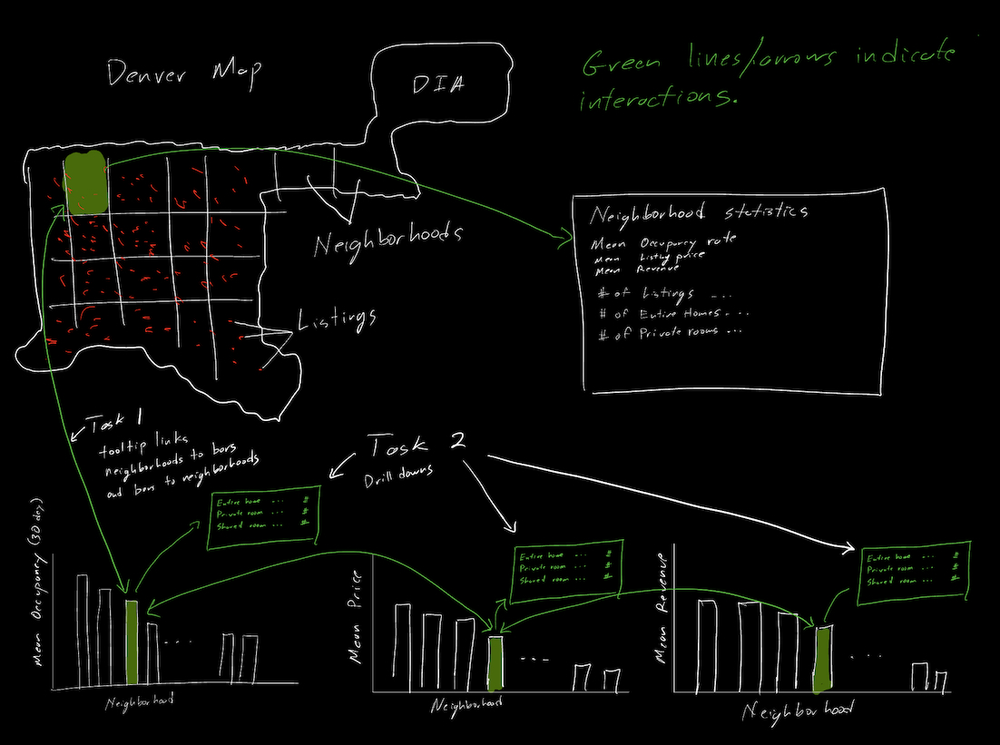

In [101]:
from IPython.display import Image
image_path = 'Viz_sketch.jpg'
Image(filename = image_path)

### Part 3: A Plan for Evaluation

#### *"Outline a preliminary evaluation that addresses your core goals with the visualization. Make sure your evaluation discusses: "*


*"the target question you want to answer"*\
What Denver neighborhood generates the highest average AirBnB revenue?
What property type generates the highest average AirBnB revenue in a given neighborhood?
Within your investment budget, what is the most lucrative property type in a given neighborhood?

"*The people you would recruit to answer that question*"\
To evaluate my visual tools, I would recruit four friends who list their properities on AirBnB or are interested in acquiring AirBnB properties in the Denver area. Their names are Hilary Sarneski-Hayes, Monte Lunacek, Mason Henderson, and Zoe Henderson. If I were taking this project to the next level, I would recruit real estate agents and investors in the Denver AirBnB market.  

"*The kinds of measures you would use to answer your data (e.g., insight depth, use cases, accuracy) and what these measures would tell you about the core question*"\
I would assess the time-to-use of the drill down feature, accuracy on tasks such as identifing the most lucrative neighborhood, identifying the most lucrative property type across the 5 most lucrative neighborhoods, etc., and the depth of insights gained from the visualizations. I would also ask participants to rate the visualizations on a scale of 1 to 5 for ease of use, usefulness, and aesthetics.

"*The approach you will use to answer that question (e.g., a journaling study, a formal experiment, etc.)*"\
I would conduct semistructured interviews with my small group of AirBnB-interested friends. If I were taking this project to the next level and including a larger participant base, I would ask participants to journal about their use and take a survey that would reveal their accuracy, insights, and time-to-use for specific tasks prompted in the survey. 

Given a large enough pool of participants, I would also conduct a formal experiment and include A/B testing on different visualization designs.

"*How you would instantiate those methods (i.e., what would your participants do?)*"\
Participants would launch a survey that loads the visualization tool and prompts them to complete a series of tasks. The survey would record the time and accuracy of their responses, and ask participants to rate the visualizations on a scale of 1 to 5 for ease of use, usefulness, and aesthetics. Lastly, the survey would prompt participants to journal about their use of the tool.

"*What criteria would you use to indicate that your visualization was successful*"\
I would consider the visualization successful if participants were able to complete the tasks with a high degree of accuracy and in a reasonable amount of time. I would also consider the visualization successful if participants were able to gain insights from the visualizations that they would not have been able to gain from the Inside AirBnB dashboard.

### Part 4: Implementation

#### Data Cleaning

Original listing price summary statistics:
count     5388.000000
mean       251.028396
std       1805.701571
min         17.000000
25%         93.750000
50%        134.000000
75%        204.000000
max      99713.000000

Listing price (0 - $1,000) summary statistics:
count    5341.000000
mean      169.205392
std       123.870152
min        17.000000
25%        93.000000
50%       132.000000
75%       200.000000
max       995.000000


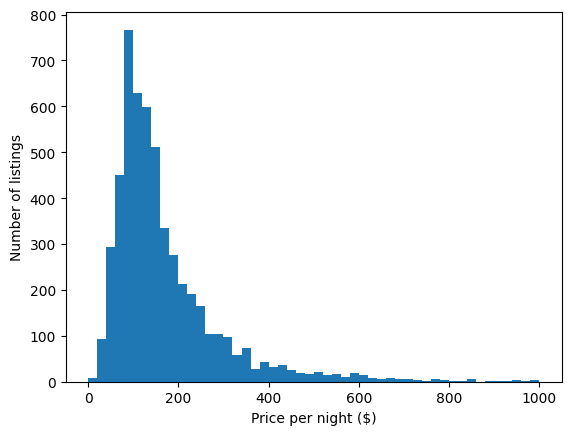

In [102]:
# Remove $ and , from price column and convert to float
listings['price'] = (data['price']
                     .str.replace('[$,]', '', regex=True)
                     .astype(float))

stats1 = listings['price'].describe().to_string(header=False)
print("Original listing price summary statistics:\n" + stats1.replace('\n ', '\n', 1))

# Reduce the rows to only those with a price less than 1000
listings = listings[listings['price'] < 1000]

stats2 = listings['price'].describe().to_string(header=False)
print("\nListing price (0 - $1,000) summary statistics:\n" + stats2.replace('\n ', '\n', 1))

# Histogram of price, with 50 bins spanning 0 to 10000
plt.hist(listings['price'], bins=50, range=(0, 1000))
plt.xlabel('Price per night ($)')
plt.ylabel('Number of listings')
plt.show()

In [103]:
# Convert columns with dates to datetime format
listings['host_since'] = pd.to_datetime(listings['host_since'])
listings['first_review'] = pd.to_datetime(listings['first_review'])
listings['last_review'] = pd.to_datetime(listings['last_review'])

Below I filter the listings to include only the top 8 most common property types. This reduces the total number of observations from 5,341 to 4,860. This reduction brings the dataset to below size limit for Altair (5,000 observations), and focuses the analysis on propertypes that have a large enough sample size to be meaningful.

In [104]:
# Filter data for property types with at least 30 listings
data = listings[listings['property_type'].isin(
    listings['property_type'].value_counts()[listings['property_type'].value_counts() >= 30].index)]

# Summarize the remaining property types
print("Property types with at least 30 listings:\n", 
      data['property_type'].value_counts(), "\n \n",
      "Total listings = ", data.shape[0], 
      sep = "")

Property types with at least 30 listings:
property_type
Entire home                    1588
Entire rental unit             1002
Entire condo                    542
Private room in home            475
Entire guest suite              459
Entire townhouse                442
Entire guesthouse               261
Private room in townhouse        91
Entire loft                      84
Entire bungalow                  74
Private room in rental unit      55
Private room in condo            31
Name: count, dtype: int64
 
Total listings = 5104


#### Explore the listing reviews

In [105]:
# Create a subset of listings that have at least one review
data_r = data[data['number_of_reviews'] > 0]
print("\nListings with at least one review:", data_r.shape[0])

# Create a subset of listings with no reviews
data_nr = data[data['number_of_reviews'] == 0]
print("Listings with no reviews:", data_nr.shape[0])


Listings with at least one review: 4366
Listings with no reviews: 738


#### Engineer occupancy rate

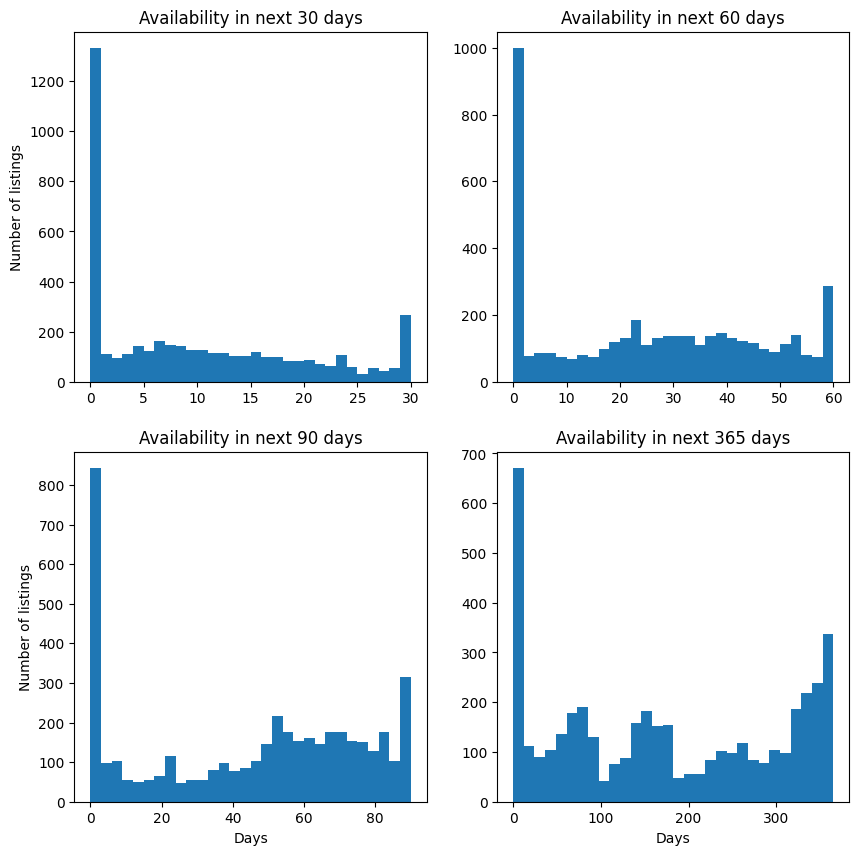

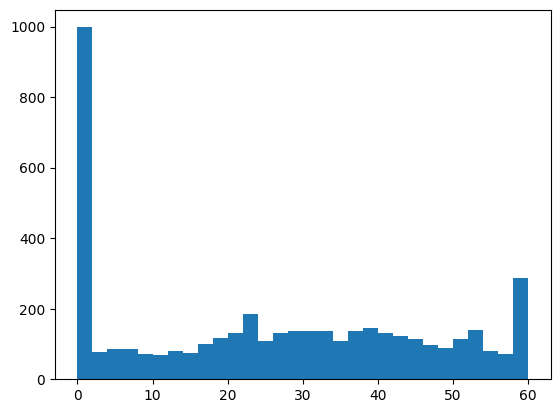

In [120]:
data_r['availability_30'].describe()
# Create a plot with 4 subplots, each showing the distribution of availability for a different number of days
fig, axs = plt.subplots(2, 2, figsize=(10, 10))
axs[0, 0].hist(data_r['availability_30'], bins=30, range=(0, 30))
axs[0, 0].set_title('Availability in next 30 days')
axs[0, 0].set_ylabel('Number of listings')
axs[0, 0].set_xlabel('')

axs[0, 1].hist(data_r['availability_60'], bins=30, range=(0, 60))
axs[0, 1].set_title('Availability in next 60 days')
axs[0, 1].set_ylabel('')
axs[0, 1].set_xlabel('')


axs[1, 0].hist(data_r['availability_90'], bins=30, range=(0, 90))
axs[1, 0].set_title('Availability in next 90 days')
axs[1, 0].set_ylabel('Number of listings')
axs[1, 0].set_xlabel('Days')

axs[1, 1].hist(data_r['availability_365'], bins=30, range=(0, 365))
axs[1, 1].set_title('Availability in next 365 days')
axs[0, 1].set_ylabel('')
axs[1, 1].set_xlabel('Days')

plt.show()


# plt.hist(data_r['availability_30'], bins=30, range=(0, 30))
# plt.show()
plt.hist(data_r['availability_60'], bins=30, range=(0, 60))
plt.show()
# plt.hist(data_r['availability_90'], bins=30, range=(0, 90))
# plt.show()
# plt.hist(data_r['availability_365'], bins=30, range=(0, 365))
# plt.show()


In [143]:
# Remove listings with no availability in the next 365 days
data_ra = data_r[data_r['availability_365'] > 0]

# Final number of listings after filtering
print("Listings with at least one review and availability in the next 365 days:", data_ra.shape[0], '\n')

# Create "occupancy" column by subtracting 30-day availability from 30
data_ra['occupancy'] = 30 - data_ra['availability_30']

# Value counts for occupancy
print(data_ra['occupancy'].value_counts())

# Create a 30-day revenue column by multiplying price by occupancy
data_ra['revenue_30'] = data_ra['price'] * data_ra['occupancy']

# Value counts for revenue
print(data_ra['revenue_30'].value_counts())

Listings with at least one review and availability in the next 365 days: 3854 

occupancy
30    819
0     179
24    161
23    146
22    143
26    142
20    128
21    126
25    124
15    117
18    113
19    113
29    112
27    110
7     108
17    103
16    102
14     98
13     97
28     96
1      89
10     86
11     83
12     82
9      71
8      64
6      59
2      56
4      54
3      43
5      30
Name: count, dtype: int64
revenue_30
0.0       179
2400.0     29
2970.0     22
3750.0     21
2250.0     20
         ... 
5373.0      1
784.0       1
1884.0      1
5954.0      1
869.0       1
Name: count, Length: 1807, dtype: int64


/var/folders/tf/yn2836q52q7dfyrf4_l8zwpm0000gn/T/ipykernel_38408/2084712412.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_ra['occupancy'] = 30 - data_ra['availability_30']
/var/folders/tf/yn2836q52q7dfyrf4_l8zwpm0000gn/T/ipykernel_38408/2084712412.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_ra['revenue_30'] = data_ra['price'] * data_ra['occupancy']


# Altair Interactive Visualization

Base map of Denver neighborhoods with AirBnB listings, tooltip with listing details, and opacity selection by neighborhood.

In [195]:
# Create a base map
base = alt.Chart(alt.Data(values=denver_geo['features'])).mark_geoshape(
    stroke='black',
    strokeWidth=0.5
).project('albersUsa').encode(
).properties(
    width=1600,
    height=1600
)


# Implement Selection based on neighbourhood_cleansed
selection = alt.selection_point(fields=['neighbourhood_cleansed'])


# Plot AirBnB listings
properties = alt.Chart(data_ra).mark_circle(size=5).encode(
    longitude='longitude:Q',
    latitude='latitude:Q',
    color=alt.condition(selection, alt.value('red'), alt.value("lightgray")),
    tooltip=['neighbourhood_cleansed', 'property_type', 'room_type', 'beds', 'price'],
    opacity=alt.condition(selection, alt.value(1), alt.value(.2))
).add_params(selection).properties(
    width=1600,
    height=1600
);

In [196]:
# Create a table with mean price, mean occupancy, mean revenue, and counts by neighborhood
agg_data = data_ra.groupby('neighbourhood_cleansed').agg(
    mean_price=('price', 'mean'),
    mean_occupancy=('occupancy', 'mean'),
    mean_revenue_30=('revenue_30', 'mean'),
    listing_count=('price', 'count')
).reset_index().round()

# Rename columns
agg_data.columns = ['neighbourhood_cleansed', 'Mean Price', 'Mean Occupancy', 'Mean Revenue', 'Listing Count']

agg_data.head()

,neighbourhood_cleansed,Mean Price,Mean Occupancy,Mean Revenue,Listing Count
0,Athmar Park,145.0,20.0,2547.0,44
1,Auraria,167.0,22.0,3465.0,3
2,Baker,132.0,22.0,2815.0,111
3,Barnum,149.0,18.0,2422.0,25
4,Barnum West,115.0,18.0,2099.0,19


In [197]:
# Bar chart of average price by neighbourhood
price_bar = alt.Chart(agg_data).mark_bar().encode(
    x=alt.X('Mean Price:Q', title='Average price per night ($)'),
    y=alt.Y('neighbourhood_cleansed:N', sort=alt.EncodingSortField(field='Mean Price', op='mean', order='descending'), title='Neighborhood'),
    color=alt.condition(selection, alt.value('red'), alt.value("lightgray")),
    opacity=alt.condition(selection, alt.value(1), alt.value(.2)),
    tooltip=['Mean Price:Q', 'Listing Count:O']
).add_params(selection).properties(
    width=600,
    height=600
)

# Bar chart of average price by property type within a selected neighbourhood
property_type_chart = alt.Chart(data_ra).mark_bar().encode(
    x=alt.X('mean(price):Q', title='Average price per night ($)'),
    y=alt.Y('property_type:N', sort=alt.EncodingSortField(field='price', op='mean', order='descending'), title='Property Type'),
    color=alt.Color('property_type:N', legend=None)
).transform_filter(
    selection
).properties(
    width=600,
    height=300
)

# Create a text layer for displaying counts
text_layer = property_type_chart.mark_text(
    align='left',
    baseline='middle',
    dx=3  # Nudges text to right so it doesn't appear on top of the bar
).encode(
    text='count()'
).properties(
    width=600,
    height=300
)

# Combine the average price bar chart and text layer
property_type_chart = (property_type_chart + text_layer);

In [202]:
# Bar chart of occupancy by neighbourhood
occupancy_bar = alt.Chart(agg_data).mark_bar().encode(
    x=alt.X('Mean Occupancy:Q', title='Average occupancy over next 30 days (%)'),
    y=alt.Y('neighbourhood_cleansed:N', sort=alt.EncodingSortField(field='Mean Occupancy', order='descending'), title='Neighbourhood'),
    color=alt.condition(selection, alt.value('red'), alt.value("lightgray")),
    opacity=alt.condition(selection, alt.value(1), alt.value(.2)),
    tooltip=['Mean Occupancy:Q', 'Listing Count:O']
).add_params(selection).properties(
    width=600,
    height=600
)

# Bar chart of average occupancy by property type within a selected neighbourhood
occupancy_type_chart = alt.Chart(data_ra).mark_bar().encode(
    x=alt.X('mean(occupancy):Q', title='Average occupancy over next 30 days (%)'),
    y=alt.Y('property_type:N', sort=alt.EncodingSortField(field='occupancy', op='mean', order='descending'), title='Property Type'),
    color=alt.Color('property_type:N', legend=None)
).transform_filter(
    selection
).properties(
    width=600,
    height=300
)

# Create a text layer for displaying counts
text_layer = occupancy_type_chart.mark_text(
    align='left',
    baseline='middle',
    dx=3  # Nudges text to right so it doesn't appear on top of the bar
).encode(
    text='count()'
).properties(
    width=600,
    height=300
)

# Combine the bar chart and text layer
occupancy_type_chart = (occupancy_type_chart + text_layer);

In [231]:
# Bar chart of 30-day revenue by neighbourhood
revenue_bar = alt.Chart(agg_data).mark_bar().encode(
    x=alt.X('Mean Revenue:Q', title='Average revenue over next 30 days ($)'),
    y=alt.Y('neighbourhood_cleansed:N', sort=alt.EncodingSortField(field='revenue_30', order='descending'), title='Neighbourhood'),
    color=alt.condition(selection, alt.value('red'), alt.value("lightgray")),
    opacity=alt.condition(selection, alt.value(1), alt.value(.2)),
    tooltip=['Mean Revenue:Q', 'Listing Count:O']
).add_params(selection).properties(
    width=600,
    height=600
)

# Bar chart of average revenue by property type within a selected neighbourhood
revenue_type_chart = alt.Chart(data_ra).mark_bar().encode(
    x=alt.X('mean(revenue_30):Q', title='Average revenue over next 30 days ($)'),
    y=alt.Y('property_type:N', sort=alt.EncodingSortField(field='revenue_30', op='mean', order='descending'), title='Property Type'),
    color=alt.Color('property_type:N', legend=None)
).transform_filter(
    selection
).properties(
    width=600,
    height=300
)

# Create a text layer for displaying counts
text_layer = revenue_type_chart.mark_text(
    align='left',
    baseline='middle',
    dx=3  # Nudges text to right so it doesn't appear on top of the bar
).encode(
    text='count()'
).properties(
    width=600,
    height=300
)

# Combine the bar chart and text layer
revenue_type_chart = (revenue_type_chart + text_layer);

# Dynamic title based on selection
# dynamic_title = alt.Chart(data_ra).mark_text(align='center',dx=0, dy=200,  fontSize=20).encode(
#     text=alt.condition(selection, 'neighbourhood_cleansed:N', alt.value(''))
# ).add_params(
#     selection
# )

# Layer the title and the chart
# revenue_type_chart = alt.layer(dynamic_title, revenue_type_chart).resolve_scale(
#     color='independent'
# );


Visualization schemes

In [234]:
# Combine the charts
# alt.hconcat(
#     alt.vconcat(
#         base + properties,
#         price_bar
#     ),
#     property_type_chart
# ).resolve_legend(
#     color="independent",
#     opacity="independent"
# )

# alt.hconcat(
#     base + properties,
#     alt.vconcat(price_bar, property_type_chart)
# ).resolve_legend(
#     color="independent",
#     opacity="independent"
# )

chart = alt.vconcat(
    base + properties,
    alt.hconcat(alt.vconcat(price_bar, property_type_chart),
                alt.vconcat(occupancy_bar, occupancy_type_chart),
                alt.vconcat(revenue_bar, revenue_type_chart))
).resolve_legend(
    color="independent",
    opacity="independent"
)

chart.save('Denver_AirBnB.html')

chart

alt.VConcatChart(...)